In [1]:
import os, warnings
from pathlib import Path

import numpy as np
import dynamo as dyn
import pandas as pd
import spateo as st
import scanpy as sc
warnings.filterwarnings('ignore')

2023-09-13 19:49:44.483655: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-09-13 19:49:44.606050: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-13 19:49:45.086225: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


## Load the data

In [2]:
sample_id = "E7_8h"
os.chdir(f"/media/pc001/Yao/Projects/Project_drosophila/Data_v4/migration-hotspot/drosophila_{sample_id}_germ_layer_new")
cpo = [(41, 1209, 57), (13, 8, -3), (0, 0, 1)]

out_image_path = f"image/germband_backbone"
Path(out_image_path).mkdir(parents=True, exist_ok=True)

In [3]:
germ_adata = st.read_h5ad(f"h5ad/{sample_id}_germband.h5ad")
germ_pc = st.tdr.read_model(f"pc_models/Germband_{sample_id}_aligned_pc_model.vtk")
germ_adata

AnnData object with n_obs × n_vars = 20424 × 8136
    obs: 'area', 'slices', 'anno_cell_type', 'anno_tissue', 'anno_germ_layer', 'actual_stage', 'scc', 'anno_tissue_new', 'V_z', 'anno_germ_layer_new'
    obsm: '2d_realign_spatial', '3d_align_spatial', 'V_cells_mapping', 'X_cells_mapping', 'X_pca', 'X_umap', 'raw_spatial', 'tdr_spatial'
    layers: 'X_counts', 'spliced', 'unspliced'

## generate backbone

In [4]:
## Calculate the Backbone of drosophila germ layer
st.tdr.add_model_labels(model=germ_pc, labels=["Germ Layer Point Clouds"]*germ_pc.n_points, key_added="backbone", where="point_data",inplace=True, alphamap=0.4, colormap="gainsboro")
_germ_pc = st.tdr.interactive_rectangle_clip(model=germ_pc, key="tissue", invert=True)[0]

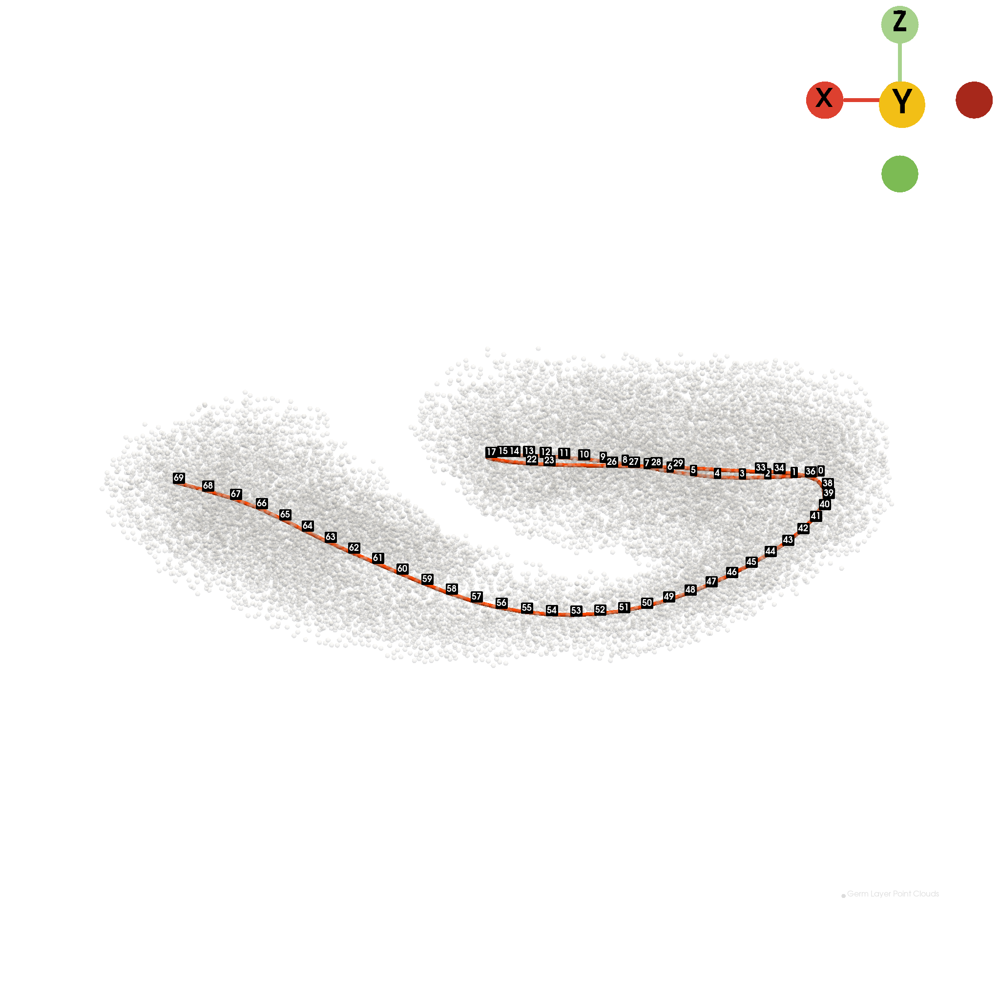

In [25]:
backbone, backbone_length, _ = st.tdr.construct_backbone(
    model=_germ_pc,
    color="orangered",
    num_nodes=70,
    rd_method="ElPiGraph",
    topology="curve",
    Lambda=1e-2,
    Mu=1,
)
st.pl.backbone(
    backbone_model=backbone,
    bg_model=germ_pc,
    bg_key="backbone",
    jupyter="static",
    cpo=cpo,
    filename=os.path.join(out_image_path, f"{sample_id}_germband_backbone_model_raw_labels.pdf")
)

## Update backbone

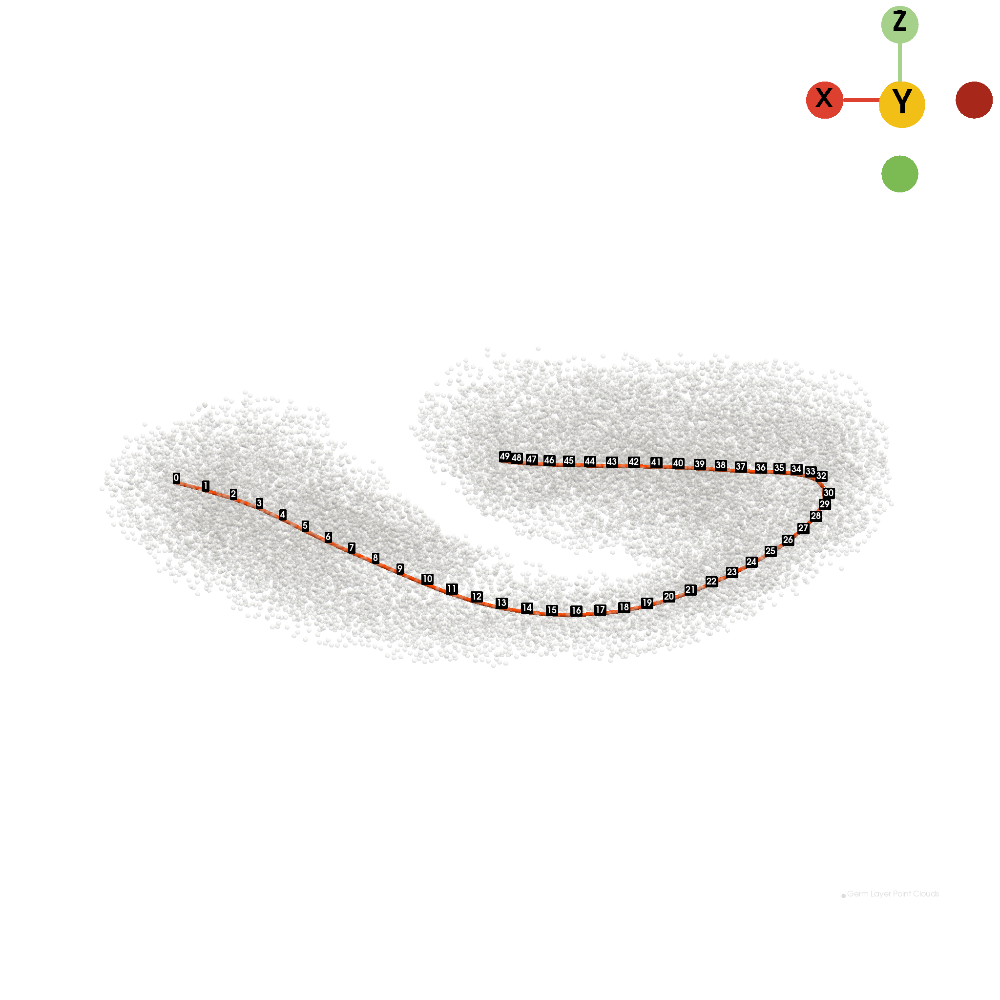

In [43]:
updated_backbone = st.tdr.update_backbone(backbone=backbone, interactive=True)
updated_backbone.point_data["updated_nodes"] = np.asarray([updated_backbone.n_points-1 - i for i in range(updated_backbone.n_points)])
st.pl.backbone(
    backbone_model=updated_backbone,
    bg_model=germ_pc,
    bg_key="backbone",
    nodes_key="updated_nodes",
    jupyter="static",
    cpo=cpo,
    filename=os.path.join(out_image_path, f"{sample_id}_germband_backbone_model_labels.pdf")
)

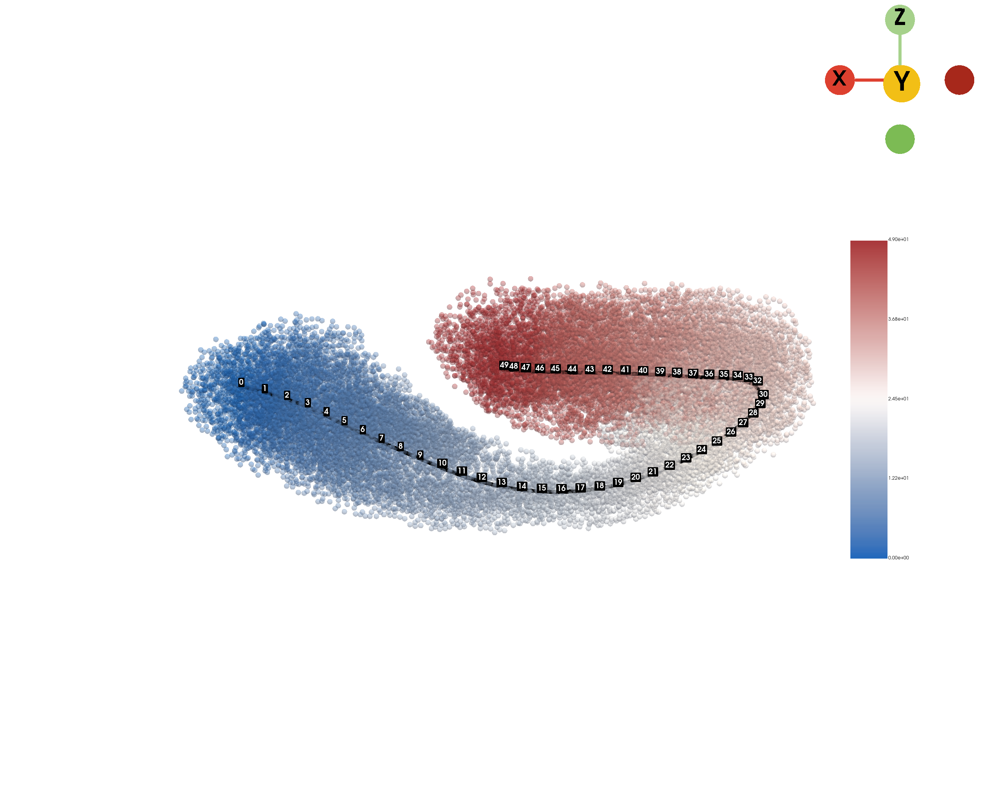

In [4]:
updated_backbone = st.tdr.read_model(f"pc_models/Germband_{sample_id}_aligned_backbone_model.vtk")
st.tdr.map_points_to_backbone(
    model=germ_pc,
    backbone_model=updated_backbone,
    nodes_key="updated_nodes",
    key_added="backbone_nodes",
    inplace=True,
)
st.pl.backbone(
    backbone_model=updated_backbone,
    backbone_model_size=10,
    backbone_key="updated_nodes",
    backbone_colormap="black",
    nodes_key="updated_nodes",
    nodes_label_size=20,
    bg_model=germ_pc,
    bg_key="backbone_nodes",
    bg_colormap="vlag",
    bg_model_size=14,
    bg_opacity=0.4,
    jupyter="static",
    cpo=cpo,
    window_size=(2560, 2048),
    filename=os.path.join(out_image_path, f"{sample_id}_germband_pc_backbone_model_with_labels.pdf")
)

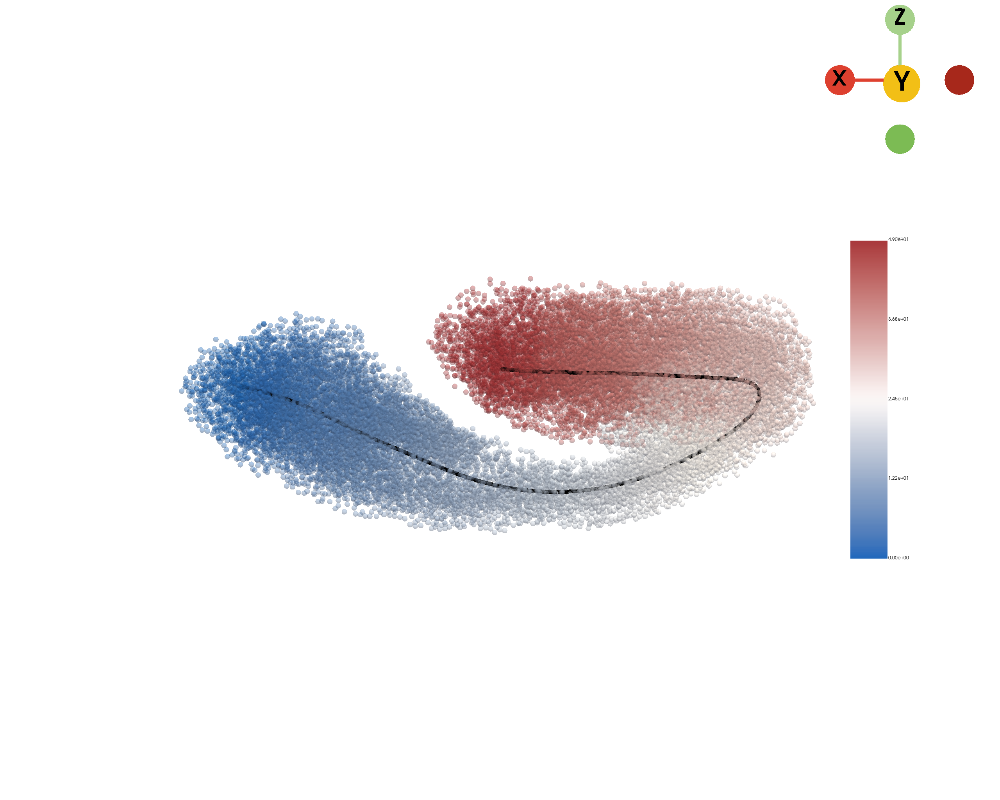

In [5]:
st.pl.backbone(
    backbone_model=updated_backbone,
    backbone_model_size=10,
    backbone_key="updated_nodes",
    backbone_colormap="black",
    nodes_key=None,
    bg_model=germ_pc,
    bg_key="backbone_nodes",
    bg_colormap="vlag",
    bg_model_size=14,
    bg_opacity=0.4,
    jupyter="static",
    cpo=cpo,
    window_size=(2560, 2048),
    filename=os.path.join(out_image_path, f"{sample_id}_germband_pc_backbone_model.pdf")
)

## Save backbone

In [54]:
obs_index = np.asarray(germ_pc.point_data["obs_index"])
germ_adata = germ_adata[obs_index, :].copy()
germ_adata.obs["backbone_nodes"] = np.asarray(germ_pc.point_data["backbone_nodes"])
germ_adata.X= germ_adata.layers["X_counts"].copy()
germ_adata.write_h5ad(f"h5ad/{sample_id}_germband_v2.h5ad", compression="gzip")

st.tdr.save_model(model=germ_pc, filename=f"pc_models/Germband_{sample_id}_aligned_pc_model.vtk")
st.tdr.save_model(model=updated_backbone, filename=f"pc_models/Germband_{sample_id}_aligned_backbone_model.vtk")
germ_adata

AnnData object with n_obs × n_vars = 20424 × 8136
    obs: 'area', 'slices', 'anno_cell_type', 'anno_tissue', 'anno_germ_layer', 'actual_stage', 'scc', 'anno_tissue_new', 'V_z', 'anno_germ_layer_new', 'backbone_nodes'
    uns: 'log1p', 'glm_degs'
    obsm: '2d_realign_spatial', '3d_align_spatial', 'V_cells_mapping', 'X_cells_mapping', 'X_pca', 'X_umap', 'raw_spatial', 'tdr_spatial'
    layers: 'X_counts', 'spliced', 'unspliced'

## Cell difference along the backbone

In [18]:
germ_adata = st.read_h5ad(f"h5ad/{sample_id}_germband_v2.h5ad")
germ_pc = st.tdr.read_model(f"pc_models/Germband_{sample_id}_aligned_pc_model.vtk")
backbone = st.tdr.read_model(f"pc_models/Germband_{sample_id}_aligned_backbone_model.vtk")
germ_adata

AnnData object with n_obs × n_vars = 20424 × 8136
    obs: 'area', 'slices', 'anno_cell_type', 'anno_tissue', 'anno_germ_layer', 'actual_stage', 'scc', 'anno_tissue_new', 'V_z', 'anno_germ_layer_new', 'backbone_nodes'
    uns: 'glm_degs', 'log1p'
    obsm: '2d_realign_spatial', '3d_align_spatial', 'V_cells_mapping', 'X_cells_mapping', 'X_pca', 'X_umap', 'raw_spatial', 'tdr_spatial'
    layers: 'X_counts', 'spliced', 'unspliced'

In [47]:
germ_adata.X= germ_adata.layers["X_counts"].copy()
sc.pp.normalize_total(germ_adata)
sc.pp.log1p(germ_adata)

In [6]:
st.tl.glm_degs(
    adata=germ_adata,
    fullModelFormulaStr=f'~cr(backbone_nodes, df=3)',
    key_added="glm_degs",
    qval_threshold=0.05,
    llf_threshold=0
)
print(germ_adata.uns["glm_degs"]["glm_result"])

|-----? Gene expression matrix must be normalized by the size factor, please check if the input gene expression matrix is correct.If you don't have the size factor normalized gene expression matrix, please run `dynamo.pp.normalize_cell_expr_by_size_factors(skip_log = True)`.
|-----> [Detecting genes via Generalized Additive Models (GAMs)] in progress: 100.0000%
|-----> [Detecting genes via Generalized Additive Models (GAMs)] finished [1638.6305s]
       status family  log-likelihood      pval      qval
Obp99a     ok    NB2   -27803.037109  0.000000  0.000000
bnb        ok    NB2    -8083.799805  0.000000  0.000000
hth        ok    NB2    -5259.128418  0.000000  0.000000
nur        ok    NB2    -4069.604980  0.000000  0.000000
abd-A      ok    NB2    -2083.167480  0.000000  0.000000
...       ...    ...             ...       ...       ...
CG1632     ok    NB2     -203.408524  0.001786  0.043777
RpL12      ok    NB2   -24288.384766  0.001940  0.047403
Hsp60A     ok    NB2    -2425.585693

In [5]:
glm_data = germ_adata.uns["glm_degs"]["glm_result"]
glm_data= glm_data.loc[glm_data["log-likelihood"] >= -2500, :]
glm_data= glm_data.loc[glm_data["pval"] <= 1e-10, :]
glm_data

,status,family,log-likelihood,pval,qval
abd-A,ok,NB2,-2076.589111,0.000000e+00,0.000000e+00
Ppn,ok,NB2,-1974.638794,0.000000e+00,0.000000e+00
Ubx,ok,NB2,-1557.671631,0.000000e+00,0.000000e+00
pip,ok,NB2,-1390.018799,0.000000e+00,0.000000e+00
Abd-B,ok,NB2,-1281.470703,0.000000e+00,0.000000e+00
cnc,ok,NB2,-870.573486,0.000000e+00,0.000000e+00
Optix,ok,NB2,-530.287048,0.000000e+00,4.203895e-45
scro,ok,NB2,-440.053375,8.996336e-43,5.633682e-40
otp,ok,NB2,-401.759003,8.920972e-34,4.536314e-31
CG34190,ok,NB2,-806.002747,3.928670e-31,1.775759e-28


Saving figure to image/germband_backbone/E7_8h_germ_layer_glm_degs_fit.pdf...
Done


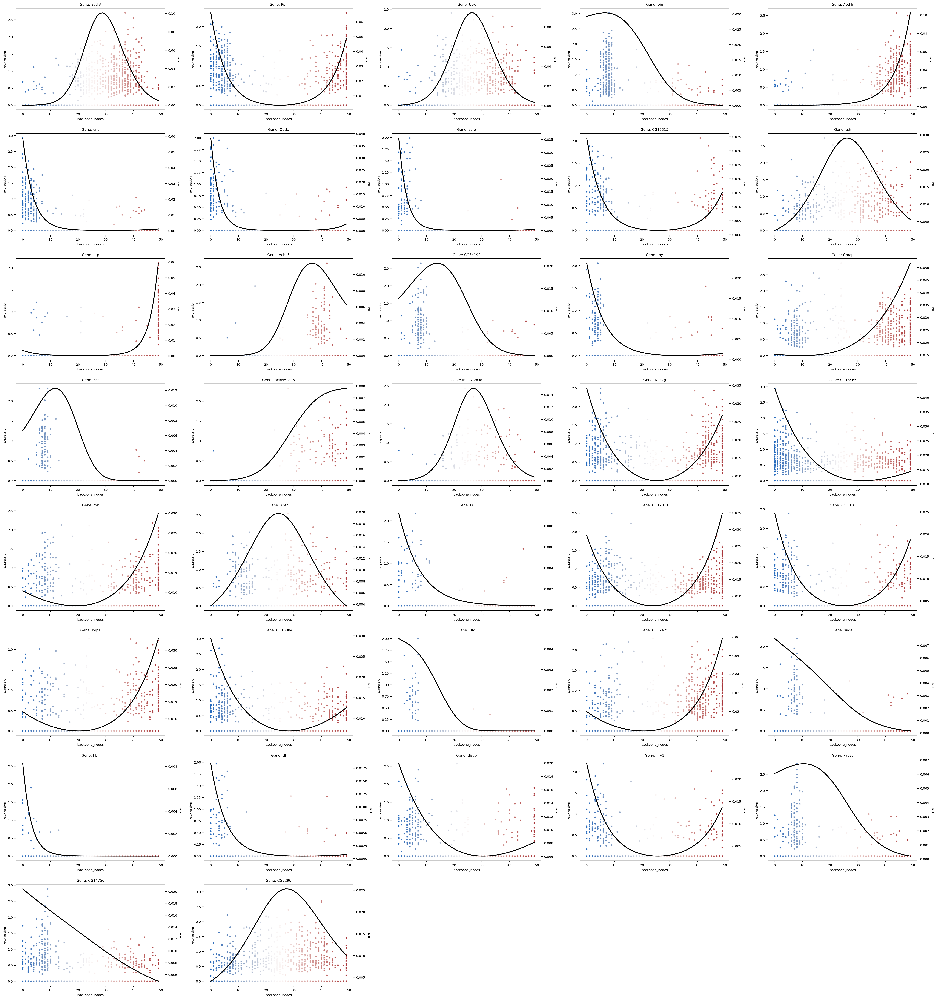

(<Figure size 3000x3200 with 74 Axes>,
 [<AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', yla

In [10]:
st.pl.glm_fit(
    adata=germ_adata,
    genes=glm_data.index.tolist(),
    ncols=5,
    feature_x="backbone_nodes",
    feature_y="expression",
    color_key="backbone_nodes",
    glm_key="glm_degs",
    show_legend=False,
    save_show_or_return="all",
    save_kwargs=dict(path=os.path.join(out_image_path, f"{sample_id}_germ_layer_glm_degs_fit"), prefix=None, ext="pdf", dpi=300)
)

Saving figure to image/germband_backbone/E7_8h_germ_layer_glm_degs_fit_selected.pdf...
Done


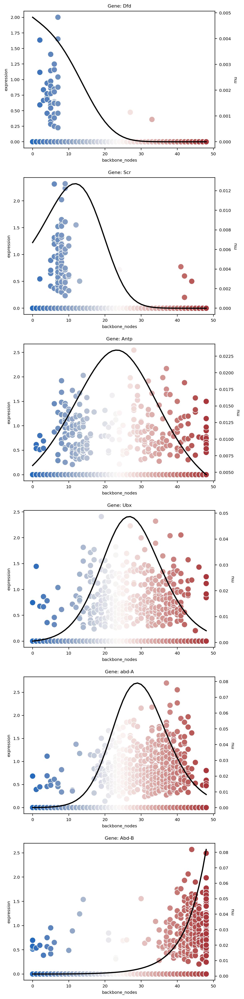

(<Figure size 600x2400 with 12 Axes>,
 [<AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>,
  <AxesSubplot:xlabel='backbone_nodes', ylabel='mu'>])

In [46]:
st.pl.glm_fit(
    adata=germ_adata,
    genes=["Dfd", "Scr", "Antp", "Ubx", "abd-A", "Abd-B"],
    ncols=1,
    point_size=100,
    feature_x="backbone_nodes",
    feature_y="expression",
    color_key="backbone_nodes",
    glm_key="glm_degs",
    show_legend=False,
    save_show_or_return="all",
    save_kwargs=dict(path=os.path.join(out_image_path, f"{sample_id}_germ_layer_glm_degs_fit_selected"), prefix=None, ext="pdf", dpi=300)
)

Saving figure to image/germband_backbone/E7_8h_germ_layer_glm_degs_fit_heatmap_all.pdf...
Done
Saving figure to image/germband_backbone/E7_8h_germ_layer_glm_degs_fit_heatmap.pdf...
Done


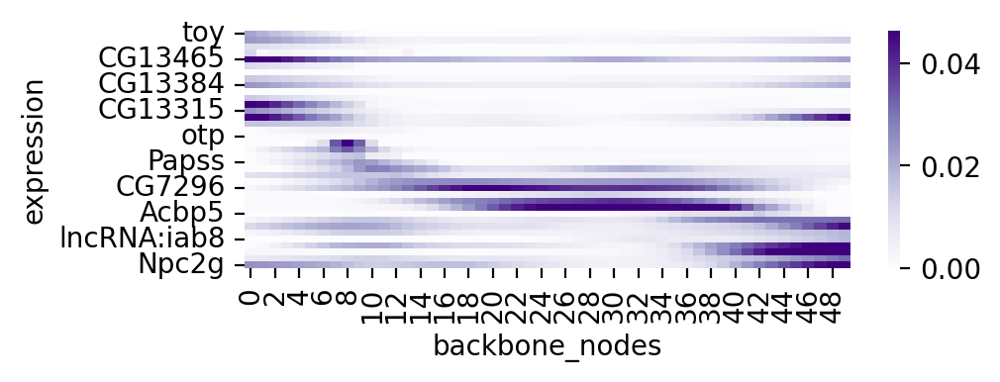

(<Figure size 600x200 with 2 Axes>,
 <AxesSubplot:xlabel='backbone_nodes', ylabel='expression'>)

In [12]:
st.pl.glm_heatmap(
    adata=germ_adata,
    genes=list(glm_data.index),
    feature_x = "backbone_nodes",
    feature_y = "expression",
    glm_key = "glm_degs",
    colormap= "Purples",
    frac=0.3,
    figsize = (6, 10),
    save_show_or_return="save",
    save_kwargs=dict(path=os.path.join(out_image_path, f"{sample_id}_germ_layer_glm_degs_fit_heatmap_all"), prefix=None, ext="pdf", dpi=300)
)
st.pl.glm_heatmap(
    adata=germ_adata,
    genes=list(glm_data.index),
    feature_x = "backbone_nodes",
    feature_y = "expression",
    glm_key = "glm_degs",
    colormap= "Purples",
    frac=0.3,
    figsize = (6, 2),
    save_show_or_return="all",
    save_kwargs=dict(path=os.path.join(out_image_path, f"{sample_id}_germ_layer_glm_degs_fit_heatmap"), prefix=None, ext="pdf", dpi=300)
)

## Genes

In [13]:
from typing import Optional, Tuple, Union

import matplotlib as mpl
import numpy as np
from pyvista import PolyData, UniformGrid, UnstructuredGrid

try:
    from typing import Literal
except ImportError:
    from typing_extensions import Literal


def add_model_labels(
    model: Union[PolyData, UnstructuredGrid, UniformGrid],
    labels: np.ndarray,
    key_added: str = "groups",
    where: Literal["point_data", "cell_data"] = "cell_data",
    colormap: Union[str, list, dict, np.ndarray] = "rainbow",
    alphamap: Union[float, list, dict, np.ndarray] = 1.0,
    mask_color: Optional[str] = "gainsboro",
    mask_alpha: Optional[float] = 0.0,
    inplace: bool = False,
) -> Tuple[Optional[PolyData or UnstructuredGrid], Optional[Union[str]]]:

        model = model.copy() if not inplace else model
        labels = np.asarray(labels).flatten()

        cu_arr = np.sort(np.unique(labels), axis=0).astype(object)
        raw_labels_hex = labels.copy().astype(object)
        raw_labels_alpha = labels.copy().astype(object)
        raw_labels_hex[raw_labels_hex == "mask"] = mpl.colors.to_hex(mask_color)
        raw_labels_alpha[raw_labels_alpha == "mask"] = mask_alpha

        # Set raw hex.
        if isinstance(colormap, str):
            if colormap in list(mpl.colormaps()):
                lscmap = mpl.cm.get_cmap(colormap)
                raw_hex_list = [mpl.colors.to_hex(lscmap(i)) for i in np.linspace(0, 1, len(cu_arr))]
                for label, color in zip(cu_arr, raw_hex_list):
                    raw_labels_hex[raw_labels_hex == label] = color
            else:
                raw_labels_hex[raw_labels_hex != "mask"] = mpl.colors.to_hex(colormap)
        elif isinstance(colormap, dict):
            for label, color in colormap.items():
                raw_labels_hex[raw_labels_hex == label] = mpl.colors.to_hex(color)
        elif isinstance(colormap, list) or isinstance(colormap, np.ndarray):
            raw_hex_list = np.array([mpl.colors.to_hex(color) for color in colormap]).astype(object)
            for label, color in zip(cu_arr, raw_hex_list):
                raw_labels_hex[raw_labels_hex == label] = color
        else:
            raise ValueError("`colormap` value is wrong." "\nAvailable `colormap` types are: `str`, `list` and `dict`.")

        # Set raw alpha.
        if isinstance(alphamap, float) or isinstance(alphamap, int):
            raw_labels_alpha[raw_labels_alpha != "mask"] = alphamap
        elif isinstance(alphamap, dict):
            for label, alpha in alphamap.items():
                raw_labels_alpha[raw_labels_alpha == label] = alpha
        elif isinstance(alphamap, list) or isinstance(alphamap, np.ndarray):
            raw_labels_alpha = np.asarray(alphamap).astype(object)
        else:
            raise ValueError(
                "`alphamap` value is wrong." "\nAvailable `alphamap` types are: `float`, `list` and `dict`."
            )

        # Set rgba.
        labels_rgba = [mpl.colors.to_rgba(c, alpha=a) for c, a in zip(raw_labels_hex, raw_labels_alpha)]
        labels_rgba = np.array(labels_rgba).astype(np.float32)

        # Added rgba of the labels.
        if where == "point_data":
            model.point_data[f"{key_added}_rgba"] = labels_rgba
        else:
            model.cell_data[f"{key_added}_rgba"] = labels_rgba

        plot_cmap = None

        # Added labels.
        if where == "point_data":
            model.point_data[key_added] = labels
        else:
            model.cell_data[key_added] = labels

        return model if not inplace else None, plot_cmap

In [14]:
GNs = ["Dfd", "Scr", "Antp", "Ubx", "abd-A", "Abd-B"]
for gn in GNs:
    _gn = str(gn).replace(":", "_") if ":" in gn else gn

    pc_index = germ_pc.point_data["obs_index"].tolist()
    exp = germ_adata[pc_index, gn].X.A.flatten()
    exp[exp <= 0] = 0

    amap = exp.copy()
    amap = amap / np.max(amap)
    amap[amap <= 0.4] = 0.2
    add_model_labels(model=germ_pc, labels=exp, key_added=gn, alphamap=amap, where="point_data", inplace=True,
                     colormap="Purples")

    st.pl.three_d_plot(
        model=germ_pc,
        key=gn,
        model_style="points",
        model_size=14,
        opacity=1,
        colormap=None,
        show_legend=True,
        jupyter=False,
        off_screen=True,
        cpo=cpo,
        window_size=(2560, 2048),
        text=gn,
        filename=os.path.join(out_image_path, f"{sample_id}_germ_layer_pc_model_{_gn}.pdf")
    )

## Interpolation

In [48]:
import numpy as np
GNs = ["Dfd", "Scr", "Antp", "Ubx", "abd-A", "Abd-B"]
interpolated_gp_adata = st.tdr.gp_interpolation(source_adata=germ_adata.copy(), spatial_key="3d_align_spatial", keys=GNs, target_points=np.asarray(germ_pc.points), device="cpu", layer="X")
interpolated_gp_adata

|-----> [Gaussian Process Regression] in progress: 100.0000%
|-----> [Gaussian Process Regression] finished [598.9976s]
|-----> Creating an adata object with the interpolated expression...
|-----> [GaussianProcessInterpolation] in progress: 100.0000%
|-----> [GaussianProcessInterpolation] finished [3221.1912s]


AnnData object with n_obs × n_vars = 20424 × 6
    obsm: '3d_align_spatial'

In [53]:
genes=["Dfd", "Scr", "Antp", "Ubx", "abd-A", "Abd-B"]
genes_adata = interpolated_gp_adata.copy()
# genes_adata.X= genes_adata.layers["X_counts"].A.copy()
genes_data = []
for gene in genes:
    exp_data = pd.DataFrame(genes_adata[:, [gene]].X, columns=["expression"], index=genes_adata.obs.index)
    mu_data = pd.DataFrame(germ_adata.uns["glm_degs"]["correlation"][gene]["mu"].values, columns=["mu"], index=genes_adata.obs.index)
    backbone_data = pd.DataFrame(germ_adata.uns["glm_degs"]["correlation"][gene]["backbone_nodes"].values, columns=["backbone_nodes"], index=genes_adata.obs.index)
    gene_data = pd.concat([exp_data, mu_data, backbone_data], axis=1)
    genes_data.append(gene_data)
    print(gene_data)

       expression        mu  backbone_nodes
0        0.000576  0.000004              34
1        0.000290  0.000004              34
2        0.000301  0.000004              34
3        0.000170  0.000002              35
4        0.000177  0.000002              35
...           ...       ...             ...
20419    0.006292  0.004830               0
20420    0.002653  0.004830               0
20421    0.005673  0.004830               0
20422    0.005107  0.004830               0
20423    0.004592  0.004830               0

[20424 rows x 3 columns]
       expression        mu  backbone_nodes
0       -0.001871  0.000067              34
1       -0.000623  0.000067              34
2       -0.001956  0.000067              34
3       -0.000900  0.000041              35
4       -0.001556  0.000041              35
...           ...       ...             ...
20419   -0.004559  0.006705               0
20420   -0.009251  0.006705               0
20421   -0.005804  0.006705               0
20422 

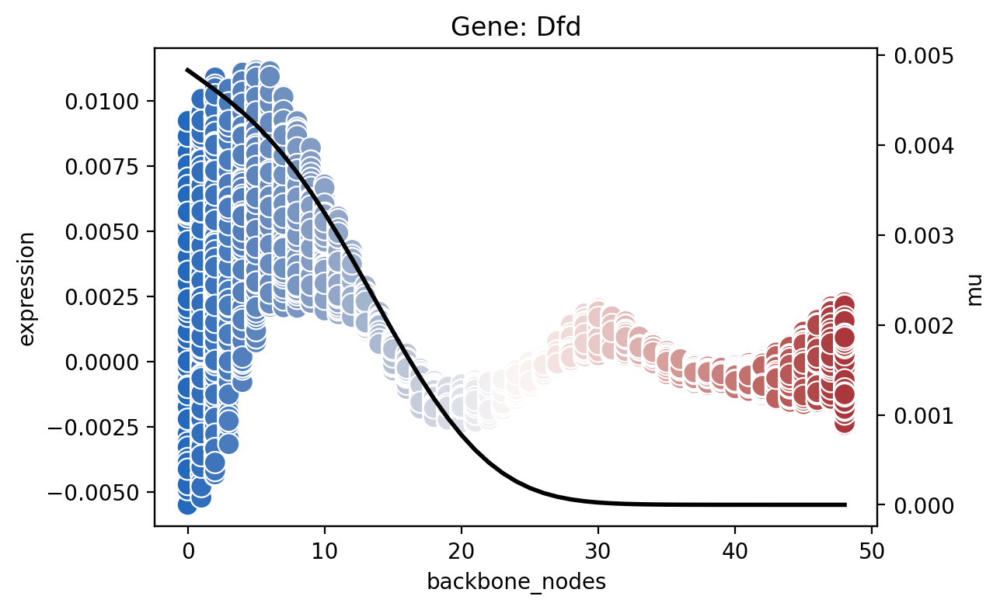

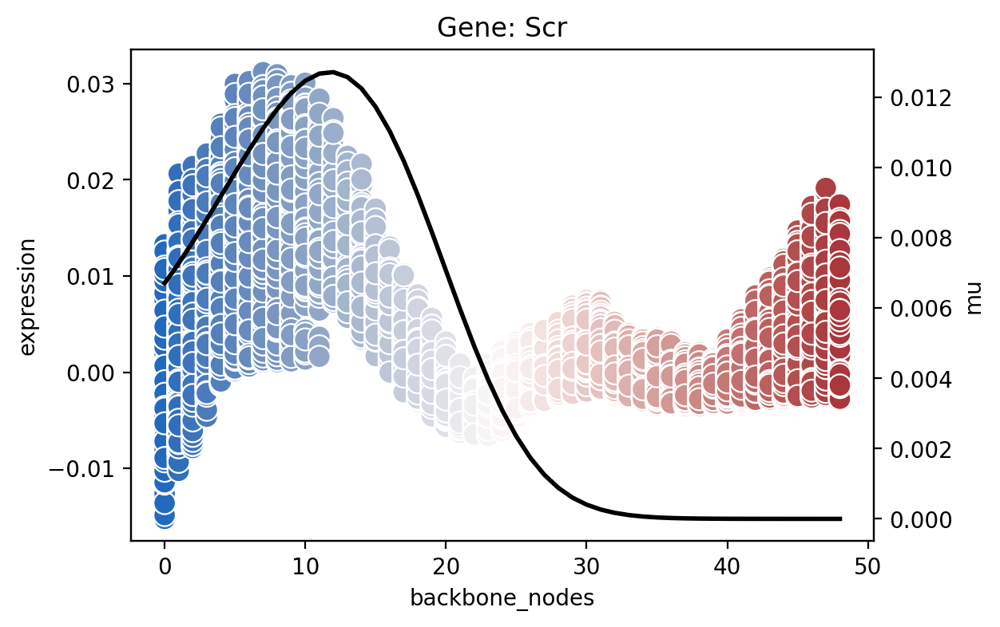

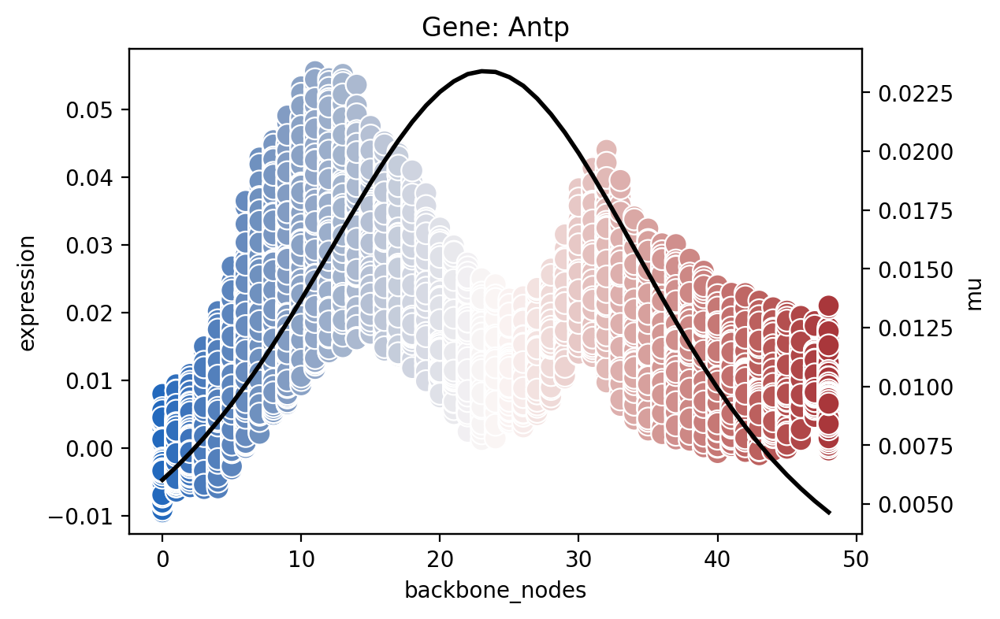

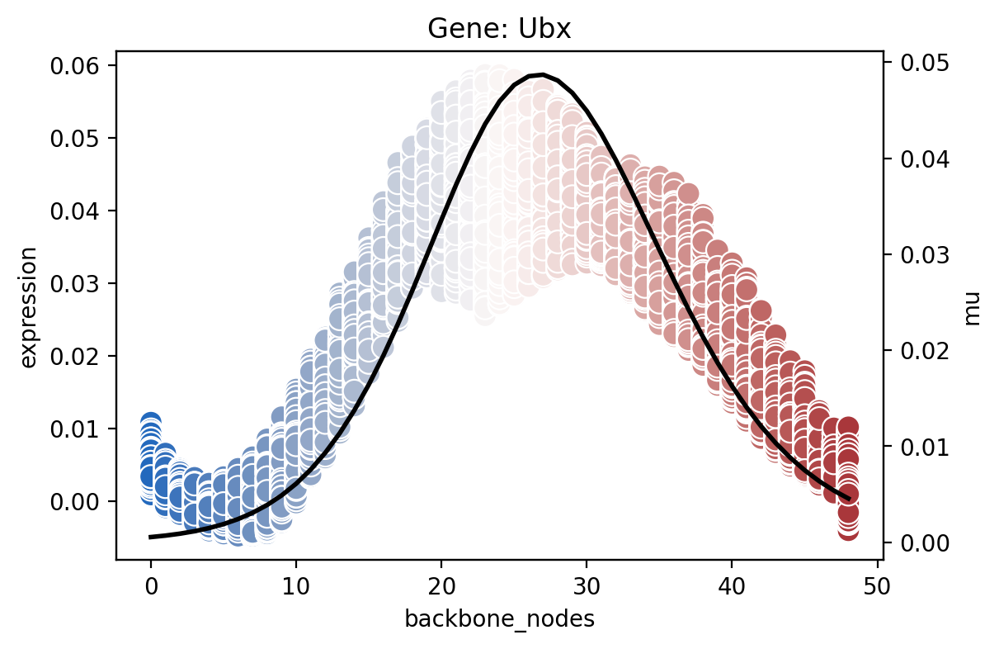

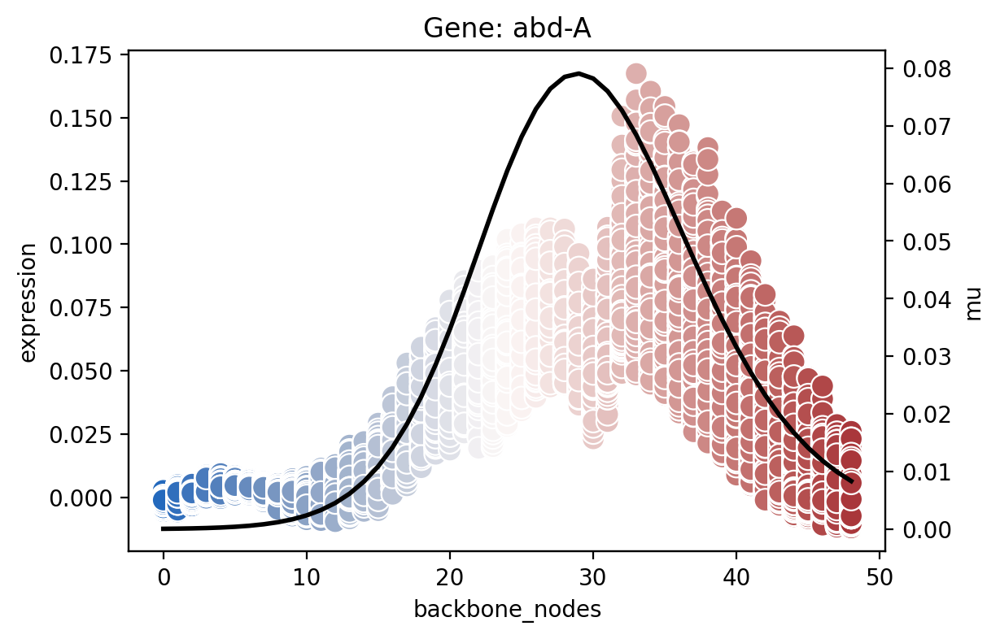

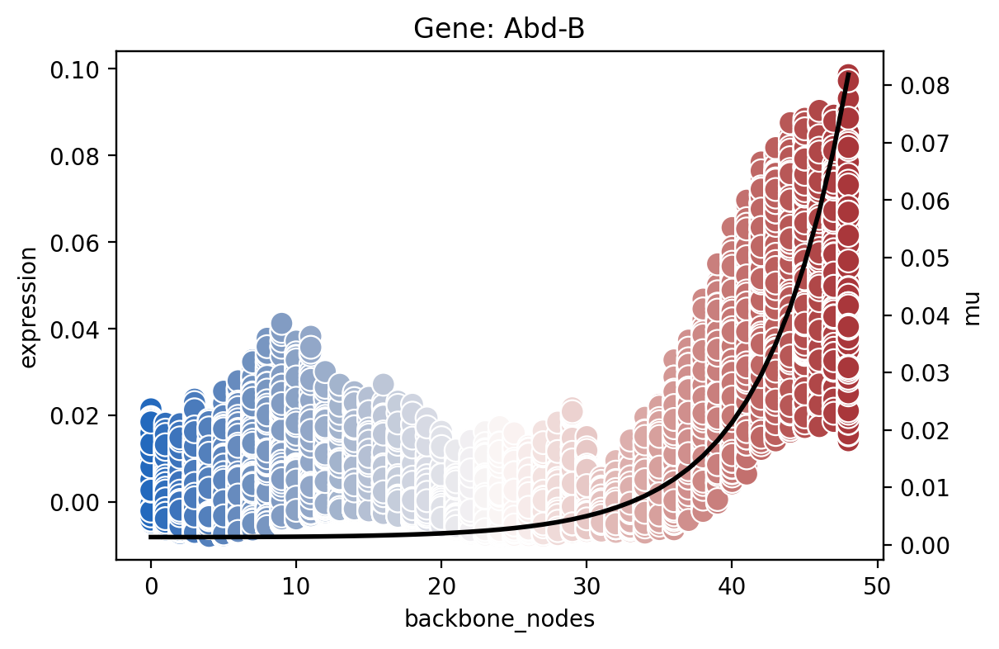

In [54]:
import matplotlib.pyplot as plt
import seaborn as sns
import math

ncols = 1
ax_size=(6, 4)
feature_x = "backbone_nodes"
feature_y="expression"


ncols = len(genes) if len(genes) < ncols else ncols
nrows = math.ceil(len(genes) / ncols)
for i, data in enumerate(genes_data):
    fig = plt.figure(figsize=ax_size)
    data.sort_values(by=feature_x, ascending=True, axis=0, inplace=True)
    ax = plt.subplot(1, 1, 1)
    ax.set_title(f"Gene: {genes[i]}")

    sns.scatterplot(
                data=data,
                x=feature_x,
                y=feature_y,
                hue=feature_x,
                palette="vlag",
                s=100,
                legend=False,
                ax=ax,
            )
    ax.set_ylabel(feature_y)

    ax = ax.twinx()
    sns.lineplot(
                data=data,
                x=feature_x,
                y="mu",
                color="black",
                lw=2,
                legend=False,
                ax=ax,
        )
    ax.set_ylabel("mu")
    plt.show()

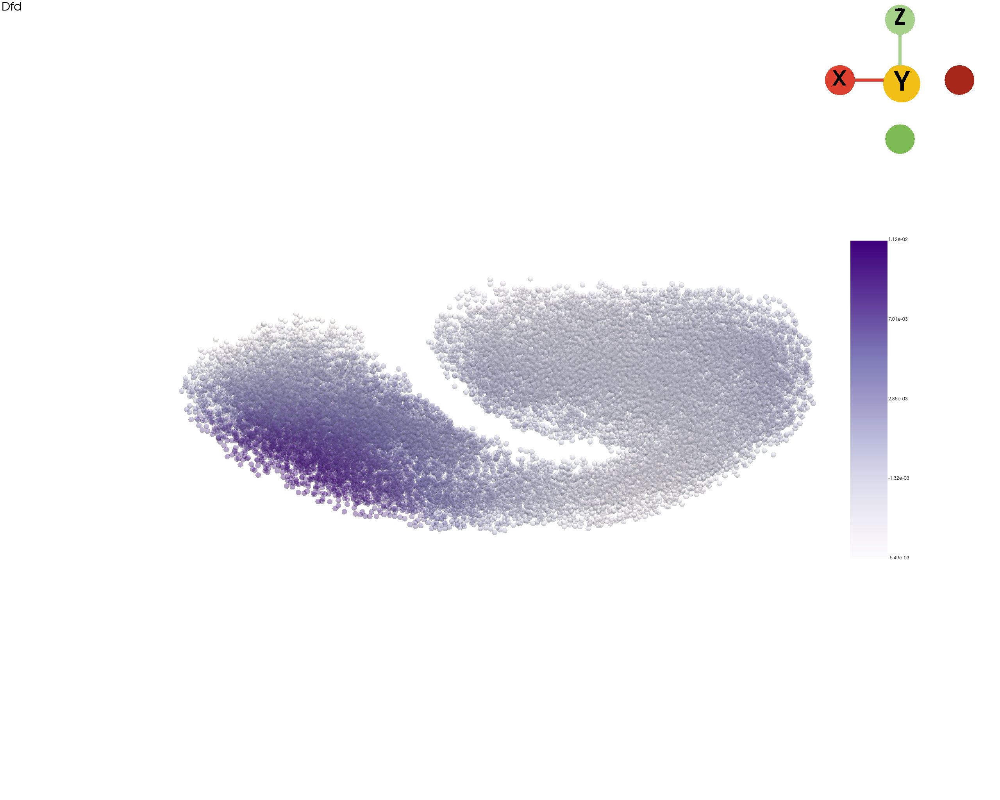

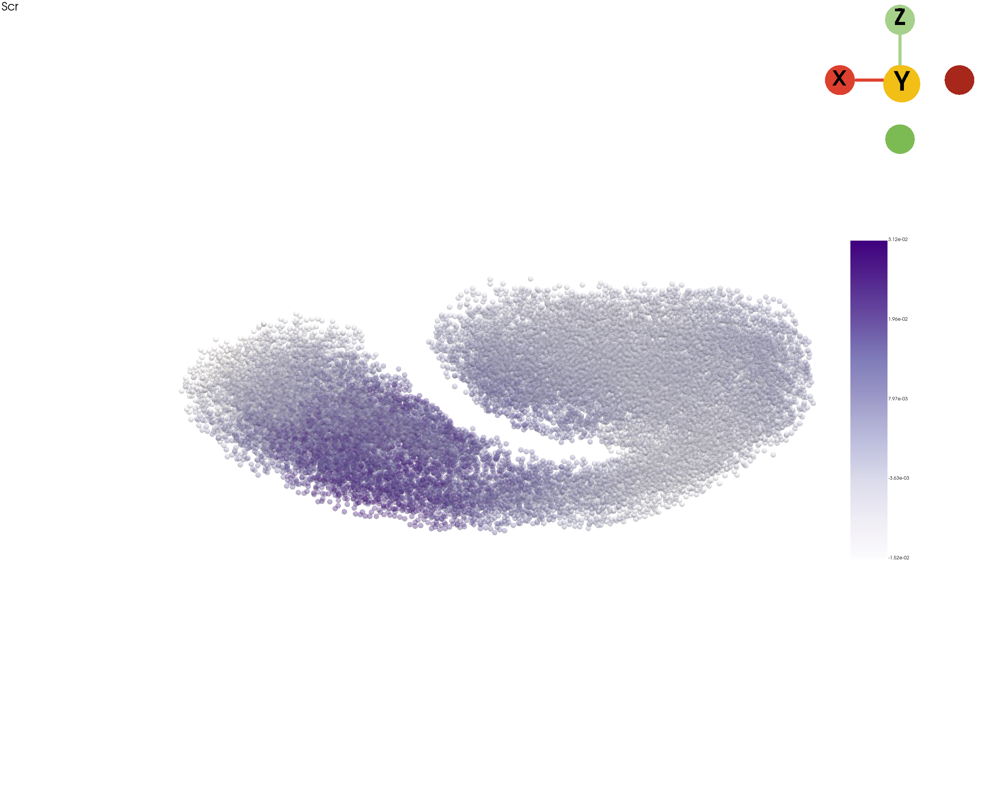

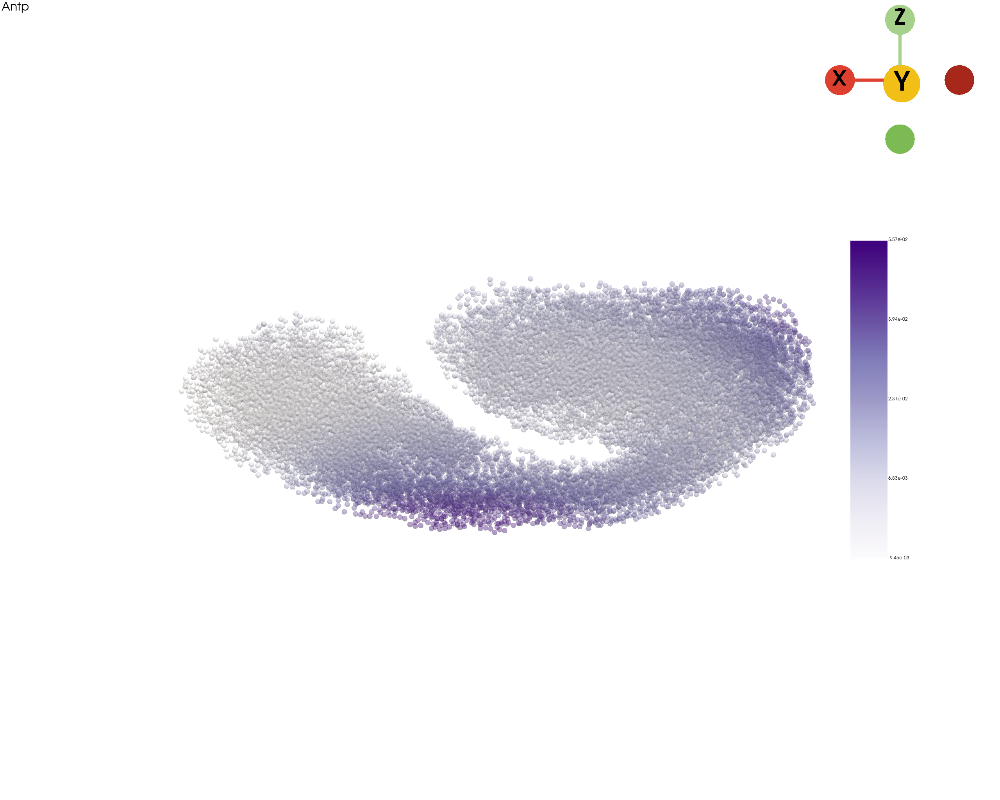

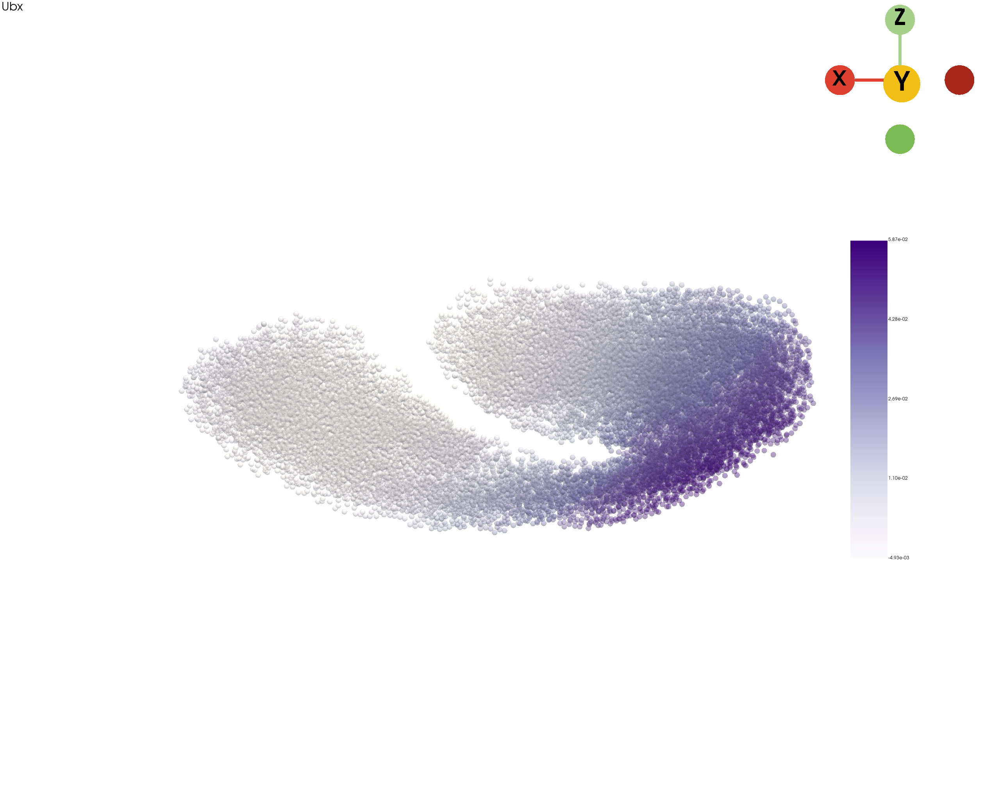

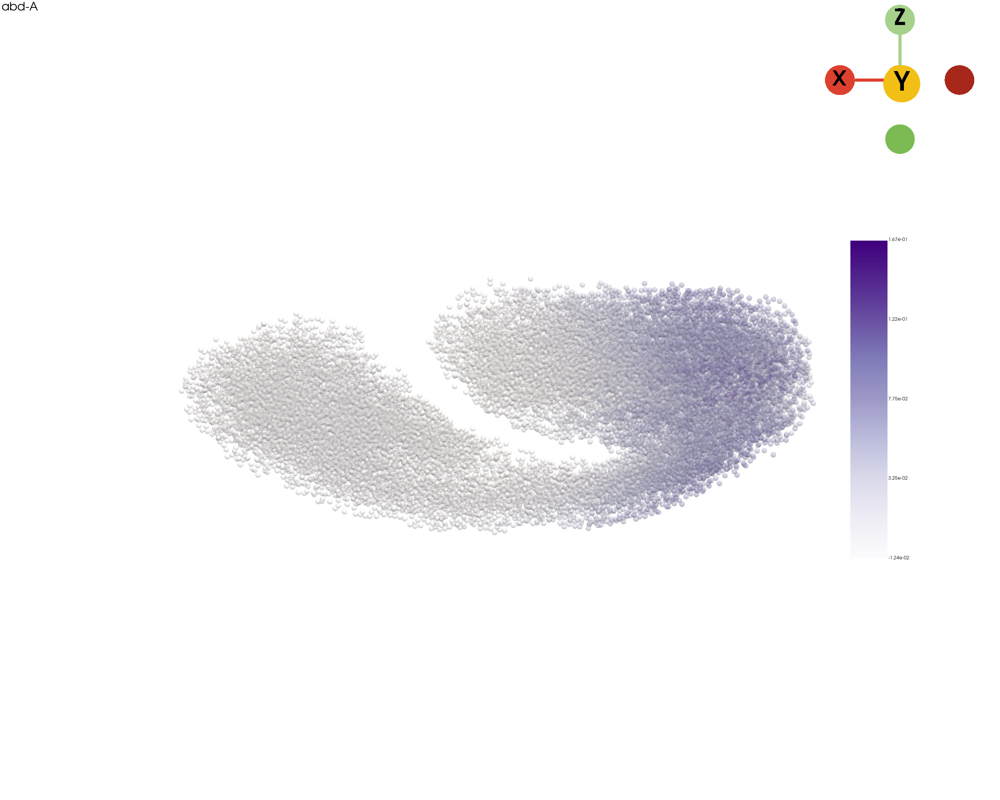

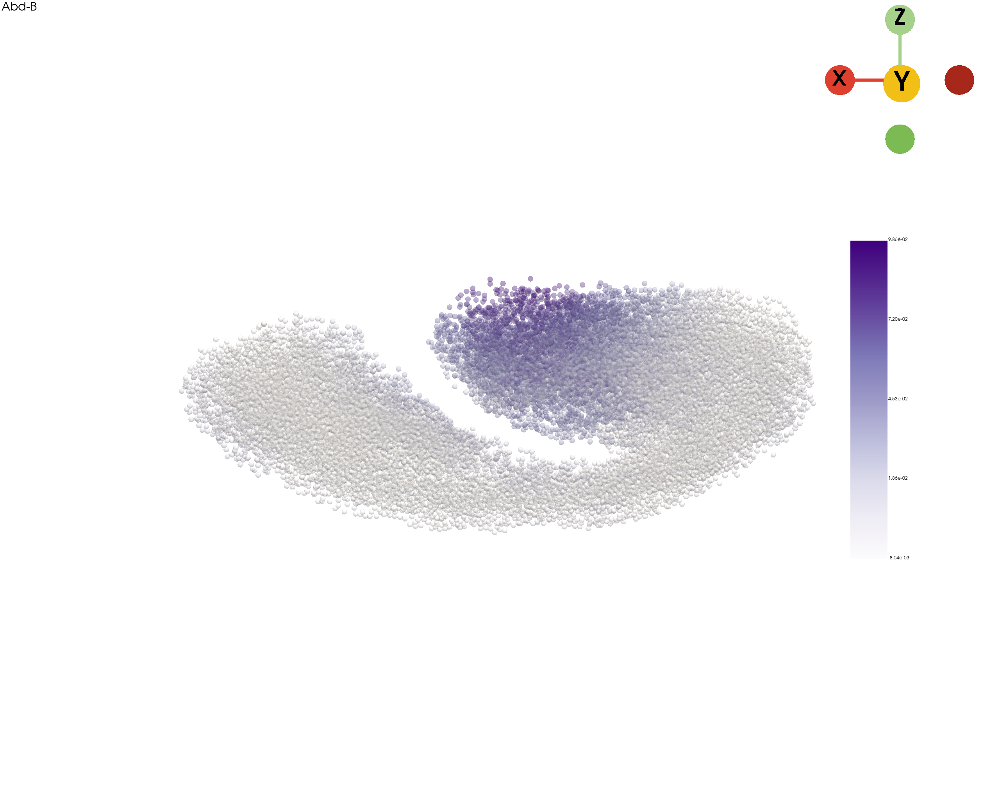

In [16]:
for gn in GNs:
    interpolated_gp_pc, _ = st.tdr.construct_pc(adata=interpolated_gp_adata.copy(), spatial_key="3d_align_spatial", groupby=gn)
    st.pl.three_d_plot(
            model=interpolated_gp_pc,
            key=gn,
            model_style="points",
            model_size=14,
            colormap="Purples",
            opacity=0.4,
            cpo=cpo,
            window_size=(2560, 2048),
            jupyter="static",
            text=gn,
            filename=os.path.join(out_image_path, f"{sample_id}_germ_layer_pc_model_{gn}_interpolated.pdf")
        )